# DBSCAN & クラスタリングの実用上の問題

このHands-onでは，下記の2種類のデータを用いてDBSCANとクラスタリングの課題を体験する．
* 人工的なN次元データ
* 中国は北京市のタクシーの位置データ

Hands-onに先立って，以下のコマンドを実行し，必要なライブラリをインストールしておこう．

In [1]:
# 地図可視化ライブラリのインストール
!pip install folium    


[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


必要なライブラリも読み込んでおきます．

In [2]:
# 表形式のデータを操作するためのライブラリ
import pandas as pd

# 行列計算をおこなうためのライブラリ
import numpy as np

# 機械学習用ライブラリsklearnのKmeansクラス
from sklearn.cluster import KMeans

# 機械学習用ライブラリsklearnのDBSCANクラス
from sklearn.cluster import DBSCAN

# 地図の可視化ライブラリ
import folium

# グラフ描画ライブラリ
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns;
sns.set(style='ticks')
%matplotlib inline

# ファイルの操作用
import os


# 警告文を表示させないおまじない
import warnings
warnings.filterwarnings('ignore')


---

## 例題1: 人工データに対するDBSCANクラスタリング

例題1で用いるデータは[University of Eastern Finlandの計算学部が公開している，人工的に作られた8000個の2次元データ](http://cs.joensuu.fi/sipu/datasets/)である．
データの各次元に特に意味はない．
以下のコードを実行して，データをデータフレームに変換し``misc_df``変数に代入しよう．

In [3]:
url = "http://cs.joensuu.fi/sipu/datasets/t4.8k.txt"
misc_df = pd.read_table(url, sep="\s+", header=0, names=['x', 'y'])

# 最初の10件のデータを表示
misc_df.head()

,x,y
0,68.601997,102.491997
1,454.665985,264.808990
2,101.283997,169.285995
3,372.614990,263.140991
4,300.989014,46.555000


下記コードを実行して散布図を書き，データの分布を確認してみよう．

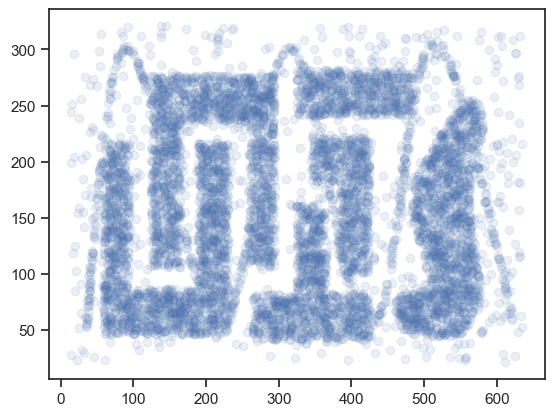

In [4]:
plt.scatter(misc_df.x, misc_df.y, alpha=0.1)
plt.show()

かなり人工的な分布だが，DBSCANの特徴を体験するにはよい題材である．
このデータを使って，DBSCANを体験してみよう．

K-meansクラスタリングでは，クラスタリングを行うためにはクラスタ数を指定する必要があった．
一方，DBSCANの特徴として，**クラスタ数を指定する必要がない**ことが挙げられる．
DBSCANは**どれくらいデータが密集していたら，データの集まりをクラスタを見なす**かの閾値さえ与えれば，あとはクラスタ数は自ずと決まる．

まずは上記データに対して，K-meansを適用してみよう．
データを眺めるとクラスタ数は6あるように見えるので，`K=6`として下記K-meansのコードを実行してみよう．

In [5]:
# クラスタリングを実行（クラスタ数は6）
kmeans_model = KMeans(n_clusters=6, init='random')
kmeans_model.fit(misc_df)

# 結果を格納
kmeans_labels = kmeans_model.labels_

クラスタリングが完了したので，下記コードを実行し，クラスタ毎にデータ点に色づけし可視化してみよう．

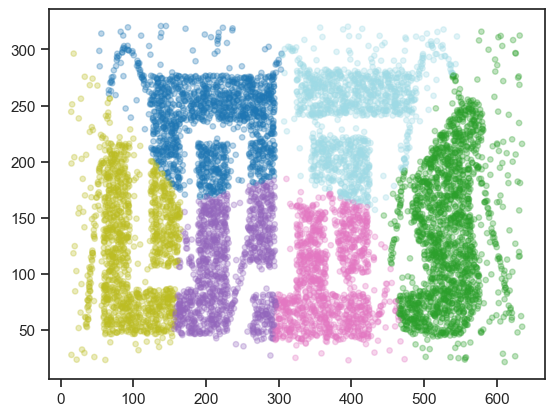

In [6]:
plt.scatter(
    misc_df.x, misc_df.y,
    c=kmeans_labels,
    alpha=0.3, # 透明度
    s=15, # マーカーのサイズ
    cmap="tab20" # カラーパレット（20色対応）
)

データが6箇所にクラスタリングされたが，期待通りにクラスタリングできていない．
本当は，「コの字」型のクラスタ，「T字」型のクラスタなどが抽出できてほしかったはず．

今回のクラスタリングの結果をよく見ると，K-meansはある点から一定距離内にある範囲をクラスタとして抽出しているように見える（[参考: ボロノイ図](https://ja.wikipedia.org/wiki/%E3%83%9C%E3%83%AD%E3%83%8E%E3%82%A4%E5%9B%B3)）．
これこそがK-meansの特徴のひとつである．
K-meansはクラスタ生成のアルゴリズム上，`クラスタの形状が超球状で，クラスタに属するデータ数はクラスタ間で等しい`という仮定を置いている．

おまけにK-meansはクラスタリング時にクラスタ数を指定する必要がある．
今回はたまたまデータの全容を目視することができたため，クラスタ数を予想することができた．
しかし，実際はデータは多次元であることが多く，データの全容を視覚的に捉えることは困難である．
そのため，クラスタ数を決定するのが難しいこともしばしばある．

上記のデータのように，
* クラスタ数を指定せずにクラスタリングしたい
* クラスタの形状が超球状以外のものにも対応したい

といったケースで有効な手法が`DBSCAN`である．
早速同じデータにDBSCANを適用してみよう．
機械学習ライブラリ`scikit-learn`には`DBSCAN`も含まれている．
すでに冒頭で`DBSCAN`クラスを読み込んでいるので，以下のコードを実行すればDBSCANでクラスタリングすることできる．

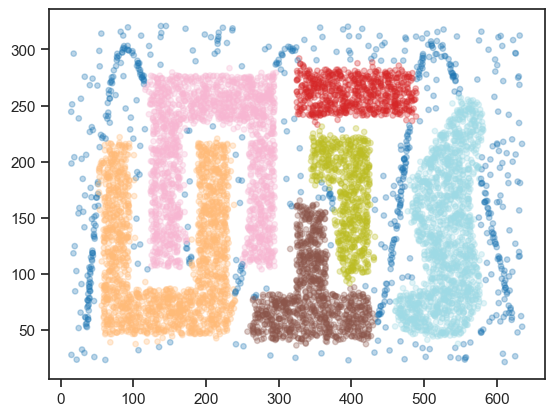

In [7]:
# クラスタリングを実行
dbscan_model = DBSCAN(eps=10, min_samples=20) #min_samplesはminPtsのこと
dbscan_model.fit(misc_df)

# 結果を格納
dbscan_labels = dbscan_model.labels_

# クラスタリング結果を色づけして可視化
plt.scatter(
    misc_df.x,
    misc_df.y,
    c=dbscan_labels,
    alpha=0.3, # 透明度
    s=15, # マーカーのサイズ
    cmap="tab20" # 濃青はノイズ（-1）ラベル
)

DBSCANによって，「コの字」型のクラスタ，「T字」型のクラスタがうまく抽出できており，直感に合うクラスタリング結果が得られた．
またクラスタの周辺にある点が「ノイズ（外れ値）」として識別できていることも確認できる．

上記コードでは，DBSCANのパラメータとして
* $\epsilon$ = 10（eps: クラスタ判定の距離）
* $minPts$ = 20（min_samples: コア点として判定するためのデータ個数）

を設定した．
授業でもお話ししたとおり，DBSCANはパラメータが非常に敏感で，適切な値を設定するのが難しい．
上記コードの`eps`，`min_samples`を適当に変更し，どのように結果が変わるか確認してみよう．


---
## 例題2: 中国は北京市のタクシーの移動データ

人工データばかり使っても面白くないので，今度は実データに対してDBSCANを適用してみよう．
次に用いるデータは，Microsoft Researchの研究グループが収集した「[北京市におけるタクシーの移動データ](https://www.microsoft.com/en-us/research/publication/t-drive-trajectory-data-sample/)」である．
このデータは，2008年の2月6日から2月8日にかけて，北京市のタクシー10357台の位置データを一定間隔で収集したもので，全部で1500万レコードのデータが含まれている．

出典は以下の通り:
> Jing Yuan, Yu Zheng, Xing Xie, and Guangzhong Sun: "Driving with knowledge from the physical world". In The 17th ACM SIGKDD international conference on Knowledge Discovery and Data mining, KDD ’11, New York, NY, USA, 2011. ACM.


今回のHands-onで全データを扱うのは時間的に厳しいので，10357台のタクシーのうち，10台のタクシーの2月6日分のデータだけに焦点を当てて分析を行ってみよう．
下記のコードを何も考えずに実行しよう．
データがダウンロードされ，`taxi_df`という変数に分析で扱うデータが格納される．


In [8]:
# データをダウンロード
!curl -O https://www.microsoft.com/en-us/research/wp-content/uploads/2016/02/06.zip

# zipファイルを解凍
!unzip -q 06.zip -d taxi-dataset

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 7643k  100 7643k    0     0  5732k      0  0:00:01  0:00:01 --:--:-- 5730k


In [9]:
# データをpandasデータフレームに格納
taxi_dfs = []
for i, filename in enumerate(os.listdir("taxi-dataset")):
    if i < 10:
        _df = pd.read_csv(
            'taxi-dataset/{}'.format(filename),
            names=['taxi_id', 'timestamp', 'longitude', 'latitude']
        ).assign(
            timestamp = lambda df: pd.to_datetime(df.timestamp)
        )

        taxi_dfs.append(_df)
    else:
        break

taxi_df = pd.concat(
    taxi_dfs
).drop_duplicates()

# 一時変数とダウンロードしたデータを削除
del taxi_dfs
!rm -rf 06.zip taxi-dataset

# データの表示
taxi_df

,taxi_id,timestamp,longitude,latitude
0,3136,2008-02-02 13:38:37,116.41042,39.94511
1,3136,2008-02-02 13:43:37,116.41053,39.94114
2,3136,2008-02-02 13:48:37,116.41085,39.93205
3,3136,2008-02-02 13:53:37,116.41151,39.91376
4,3136,2008-02-02 13:55:56,116.41140,39.90815
...,...,...,...,...
1789,7807,2008-02-08 17:16:42,117.21345,40.14508
1790,7807,2008-02-08 17:21:42,117.21345,40.14509
1791,7807,2008-02-08 17:26:42,117.21346,40.14510
1792,7807,2008-02-08 17:31:42,117.21346,40.14510


ダウンロードしたデータは全部で16892レコードあることが確認できる．
また，データは
* `taxi_id`: タクシーのID
* `timestamp`: データが収集された日時
* `longitude`: タクシーの経度
* `latitude`: タクシーの緯度

で構成されていることが分かる．

下記コードを実行し，データをX軸を経度，Y軸を緯度とする平面上にマッピングしてみよう．

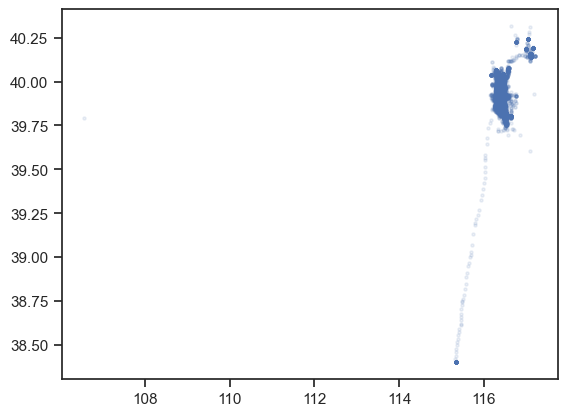

In [10]:
plt.scatter(taxi_df.longitude, taxi_df.latitude, alpha=0.1, s=5)
plt.show()

なんだかよく分からない...
これを眺めていても面白くないので，下記コードを実行し，データを地図にマッピングしてみよう．

In [11]:
# foliumで地図オブジェクトを作成
beijing_map = folium.Map(location=[39.916668, 116.383331], zoom_start=12)

# 地図上にデータをプロット
for latitude, longitude in taxi_df[['latitude', 'longitude']].values.tolist():
    circle = folium.Circle(
        radius=30,
        location=(latitude, longitude),
        fill=True,
        fill_opacity=0.2
    )
    circle.add_to(beijing_map)

# 地図を表示
beijing_map

北京市の地図上に，2月6日の10台のタクシーの移動データ（位置データ）がプロットされた．

今回のHands-onでは，このデータにDBSCANを適用することで，密な位置データをクラスタとして抽出する．
タクシーは色々な所に移動して停車しているが，（時間を無視して）密なクラスタを抽出することで，タクシーがよく集まる場所，つまり
* タクシーがよく休憩しているエリア
* タクシーがよくお客を乗せるエリア（人が集まる場所）

を発見しよう．

例題1でも述べたように，DBSCANはパラメータに敏感である．
パラメータ設定にはデータに対する深い洞察と理解が必要となる．

$\epsilon$（eps）パラメータはクラスタに含める点を見つけるために，コア点からの許容距離を定めるものであった．
地理座標系では地球上のどこにいるかによって緯度・経度1度あたりの距離は変わってくるが，ここでは**1度あたり85.379km**と考えることにしよう．
また，**100m**範囲内に別の点があれば，密になっていると考えることにしよう．
この仮定に基づくと，$\epsilon$パラメータは`eps=0.00117124`になる．
$minPts$パラメータは，`min_samples=10`くらいだということにしておこう．

では，下記コードを実行し，DBSCANを`taxi_df`に適用しよう．


In [12]:
# クラスタリングを実行
dbscan_model = DBSCAN(eps=0.00117124, min_samples=10) #min_samplesはminPtsのこと
dbscan_model.fit(taxi_df[['latitude', 'longitude']])

# 結果を格納
taxi_df['cluster'] = dbscan_model.labels_

cluster_num = len(set(taxi_df['cluster']))-1
print("クラスタ数: ", cluster_num)

クラスタ数:  104


DBSCANによって104個のクラスタが抽出された．
下記のコードを実行し，最後に各クラスタを地図上で確認してみよう．
色づけのためにコードが長くなっているが，やっていることはクラスタ毎に色を指定しているだけである（ノイズ（外れ値）クラスタはほぼ透明の灰色に）．

In [13]:
# foliumで地図オブジェクトを作成
beijing_map = folium.Map(location=[39.916668, 116.383331], zoom_start=12)

# カラーマップを用意
cmap = plt.cm.get_cmap('prism')

# 地図上にデータをプロット
for latitude, longitude, cluster_id in taxi_df[['latitude', 'longitude', 'cluster']].values.tolist():
    if cluster_id == -1:
        cluster_color = 'gray'
        opacity = 0.2
    else:
        cluster_color = mcolors.to_hex(cmap(cluster_id / cluster_num))
        opacity = 0.8
    
    circle = folium.Circle(
        radius=30,
        location=(latitude, longitude),
        fill=True,
        opacity=opacity,
        fill_opacity=0.2,
        color=cluster_color
    )
    circle.add_to(beijing_map)

# 地図を表示
beijing_map


---
## クイズ

※ 以下のクイズの回答にGoogle Colaboratoryを使いたい方は[コチラ](https://colab.research.google.com/github/hontolab-courses/ml-lecturenote/blob/main/content/quiz/dbscan-and-others.ipynb)をクリック．

(L4-Q1)=
### Q1: クラスタ内誤差平方和

[第3章で用いた人工データ](content/kmeans-and-hierarchical-clustering.ipynb)（University of Eastern Finlandの計算学部が公開しているデータセット）に対して，K-meansクラスタリングを適用することを考える．
データを可視化すれば最適なクラスタ数は推測できるが，ここでは最適なクラスタ数は未知であると仮定する．

当該データをデータフレームに変換し，変数`s1_df`に格納しなさい．
さらに，クラスタ数を3（`K=3`）として`s1_df`にK-meansクラスタリングを適用し，クラスタ内誤差平方和（SSE）を計算しなさい．

※ ヒント: scikit-learnライブラリを用いた場合，SSEの値はクラスタリング実行後，モデルの`inertia_`プロパティにアクセスすれば取得できる（[参考](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)）．

(L4-Q2)=
### Q2: エルボー法によるクラスタ数の決定

Q1におけるクラスタ数`K`の値を1から20まで1ずつ変化させ，それぞれの`K`におけるクラスタ内誤差平方和を求めなさい．

(L4-Q3)=
### Q3: エルボー法によるクラスタ数の決定

Q2で計算したクラスタ内誤差平方和の値とエルボー法を用いて，Q1のデータにK-meansを適用する際の最適なクラスタ数を決めなさい．

---
## おまけクイズ

### Q4: データ間の距離

以下の関数`generate`は，各次元の定義域が$[-1, 1]$であるN次元空間に$K個のデータをランダムに生成する関数である．
`generate`関数はK行N列の行列を返す．

In [14]:
def generate(N, K):
    return np.random.uniform(-1, 1, (K, N))

例えば，$N=2$，$K=10$の場合，以下のように`generate`関数は2次元のデータを10個生成し，行列形式で返す．
各行がデータ点に対応する．

In [15]:
generate(N=2, K=10)

array([[-0.46559812,  0.05354133],
       [ 0.15051401, -0.45296284],
       [ 0.00172375, -0.40202366],
       [-0.29064091,  0.57877438],
       [ 0.90954668, -0.88558217],
       [ 0.25393446,  0.37870589],
       [ 0.80666531, -0.93391267],
       [-0.12171067,  0.11201194],
       [ 0.60557624,  0.64893761],
       [ 0.98141245, -0.62052879]])

`generate`関数を使ってランダムに生成された2次元の10個のデータにについて，全データ間のユークリッド距離を計算し，その結果を変数`dist`に格納しなさい．

※ ヒント: scipyライブラリの`spatial.distance.pdist`関数を用いるとよい（[参考](https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.distance.pdist.html#scipy.spatial.distance.pdist)）．

### Q5: データ間の距離の最小値と最大値

Q4で求めた距離の最小値と最大値を求め，その差の絶対値`max_dist_delta`を計算しなさい．
各次元の定義域がであるN次元空間においては，`max_dist_delta`の最大値は$2\sqrt{N}$となる．
このことを踏まえて，最大値が1となるよう`max_dist_delta`を正規化した`normalized_max_dist_delta`も計算しなさい．

※ ヒント: リストやnumpy.darrayの要素の最小値，最大値を計算するには`min`，`max`関数が使える．

#### 補足: 距離の差を$2\sqrt{N}$で正規化するのか？

各次元の定義域が[-1, 1]であるN次元空間における点同士のユークリッド距離がとりうる最大値は，
* 1次元空間では距離の最大値は$2=2\sqrt{1}$
* 2次元空間では距離の最大値は$2 \sqrt{1^2 + 1^2}=2\sqrt{2}$
* 3次元空間では距離の最大値は$2 \sqrt{1^2 + 1^2 + 1^2}=2\sqrt{3}$

となる．
この観察から分かるように，N次元空間における点同士の距離がとり得る最大値は$2\sqrt{N}$となり，次元数が増えるにつれてとりうる距離の最大値が大きくなる．
そのため，単純に最大距離と最小距離の差の「絶対値」を調べても，相対的に差が小さくなっているのか分からない．
そこで，距離を$2\sqrt{N}$で割ることで，最大距離と最小距離の差を正規化（最大値が1になるように変換）する．

### Q6: 関数化

Q4とQ5で行ったことを抽象化すると，以下のように書ける：
1. 各次元の定義域が$[-1, 1]$である$N$次元空間上で$K$個のデータをランダムに生成
2. 各データ間のユークリッド距離の最小値と最大値の差を計算
3. ステップ2で求めた差を$2\sqrt{N}$で正規化した値（`normalized_max_dist_delta`）を計算

ステップ1からステップ3を任意の回数だけ繰り返し，得られた`normalized_max_dist_delta`の平均値を$\bar{\delta_{dist}}$と定義する．
$\bar{\delta_{dist}}$を求める関数`calc_mean_normalized_max_dist_delta`を定義せよ．
なお，この関数の引数は`N`，`K`，`iter`（ステップ1からステップ3まで繰り返す回数）の3つとする．

### Q7: 次元の呪い

Q6で定義した$\bar{\delta_{dist}}$について，$K=50$，$iter=100$と固定して$N$を1から1000まで1ずつ変化させたときにどのように変化するか観察しなさい．